<a href="https://colab.research.google.com/github/moey920/Object-Detection/blob/master/Detectron2_final_wideLabel.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 2. Detectron2 설치하기

In [ ]:
# 종속 패키지(dependencies) 설치, 설치후에 Restart Runtime이 나오면 클릭해줍니다..
!pip install -U torch torchvision cython
!pip install -U 'git+https://github.com/facebookresearch/fvcore.git' 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
torch.__version__

Requirement already up-to-date: torch in /usr/local/lib/python3.6/dist-packages (1.5.1+cu101)
Requirement already up-to-date: torchvision in /usr/local/lib/python3.6/dist-packages (0.6.1+cu101)
Requirement already up-to-date: cython in /usr/local/lib/python3.6/dist-packages (0.29.20)
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-_72qv8l1
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-_72qv8l1
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-_vfq243p
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-_vfq243p
     |████████████████████████████████| 276kB 4.0MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.1-cp36-none-any.whl size=45053 sha256=940f6f47423f79c5ee3220f03174b9c79c20dca4bfe33ddad56b3330c0d93836
  Stored in directory: /tmp/pip-ephem-wheel-cache-xth4o2lh/wheels/48/53/79/3c6485543a4455a0006f5db590ab9957622b6227011941de06
  C

'1.5.1+cu101'

In [ ]:
# Detectiorn2 repo 클론, 인스톨
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 89, done.
remote: Counting objects: 100% (89/89), done.
remote: Compressing objects: 100% (72/72), done.
remote: Total 5655 (delta 30), reused 47 (delta 16), pack-reused 5566
Receiving objects: 100% (5655/5655), 2.65 MiB | 2.81 MiB/s, done.
Resolving deltas: 100% (4051/4051), done.
Obtaining file:///content/detectron2_repo
  Created wheel for pycocotools: filename=pycocotools-2.0.1-cp36-cp36m-linux_x86_64.whl size=267032 sha256=c9178b8c62f317ea59974d14958caa6e337f1851c5c2015343cdaadcf60431ad
  Stored in directory: /root/.cache/pip/wheels/86/19/08/49b25f258ead1f861c9ab2fc41f73636f2928859adbb0e9797
Successfully built pycocotools
  Found existing installation: pycocotools 2.0
    Uninstalling pycocotools-2.0:
      Successfully uninstalled pycocotools-2.0
  Running setup.py develop for detectron2


In [ ]:
# 인스톨이 완료되면 Colab Runtime을 다시 시작해주세요. 

# 기본 설정
# detectron2 logger 설정
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# 자주 사용하는 라이브러리 임폴트
import numpy as np
import cv2
import random
import os
from google.colab.patches import cv2_imshow

# 자주 사용하는 detectron2 유틸 임폴트 
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# 1. Google Drive Api

In [ ]:
# Auth 승인을 받습니다. 코드 실행 시 링크가 나오면 들어가서 계정을 인증하고 인증 코드를 복사해 붙여넣습니다.
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials
   
# PyDrive Authentication
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [ ]:
# Folder Id로 FileList 받아오기
# 폴더 ID는 개인 드라이브에서 폴더에 들어가면 https://drive.google.com/drive/folders/ 이후에 나오는 주소입니다.

folder_id = '1GEdPmRmfJrrkiyR8iSjePzILEy8kczM_'
   
def ListFolder(parent):
    filelist=[]
    file_list = drive.ListFile({'q': "'%s' in parents and trashed=false" % parent}).GetList()
    for f in file_list:
        if f['mimeType']=='application/vnd.google-apps.folder': # if folder
            filelist.append({"id":f['id'],"title":f['title'],"list":ListFolder(f['id'])})
        else:
            filelist.append({"title":f['title'],"id":f['id']})
    return filelist
   
   
file_lists = ListFolder(folder_id)

In [ ]:
# Local (colaboratory) directory 지정
# choose a local (colab) directory to store the data.
import os

local_download_path = os.path.expanduser('')
try:
	os.makedirs(local_download_path)
except: pass

In [ ]:
# Filename 저장, 여기까지 하면 구글 드라이브 폴더 내의 파일을 Colab에 지정한 장소에 업로드 됩니다.
ret = []
for file in file_lists:
    print('title: %s, id: %s' % (file['title'], file['id']))
    fname = os.path.join(local_download_path, file['title'])
    print('downloading to {}'.format(fname))
    f_ = drive.CreateFile({'id': file['id']})
    f_.GetContentFile(fname)
    print(fname)
    ret.append(fname)

title: dataset.zip, id: 1alken_NFiWB23oADz6KEiuNkZwLJKMDm
downloading to dataset.zip
dataset.zip


In [ ]:
#import os
#os.chdir('receipt')
!ls

adc.json  dataset.zip  detectron2_repo	sample_data


In [ ]:
# 업로드한 파일을 압축해제합니다.
!unzip dataset.zip > /dev/null

In [ ]:
#os.chdir('../')
!ls

adc.json  dataset.zip  detectron2_repo	sample_data  train  val


# 커스텀 데이터셋 학습하기

In [ ]:
# 인스톨이 완료되면 Colab Runtime을 다시 시작해주세요. 

# 기본 설정
# detectron2 logger 설정
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# 자주 사용하는 라이브러리 임폴트
import numpy as np
import cv2
import random
import os
from google.colab.patches import cv2_imshow
import matplotlib
import json

# 자주 사용하는 detectron2 유틸 임폴트 
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

In [ ]:
import os
import numpy as np
import json
from detectron2.structures import BoxMode
import itertools
import cv2

def get_receipt_dicts(img_path,json_path):
    '''
    AD Oct 2019 : loading function to calculate the bboxes from the masks (as it does not exist so far in Detectron2)
    expected format:
    
    {'file_name': 'path/to/image',
    'height' : imgheight,
    'width': imgwidth,
    'annotations':
    [{'bbox': [xmin,ymin,xmax,ymax], 'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'segmentation': [[polygon/coordinates/x/y]],
    'category_id': 0, 'iscrowd': 0}, 
    {'bbox': [xmin2,ymin2,xmax2,ymax2], 'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'segmentation': [[polygon2/coordinates/x/y]],
    'category_id': 0, 'iscrowd': 0},
    
    etc ...]
    
    }
    INPUTS:
        img_path . str, path to the images
        json_path. str, path to the json annotation file (coco format)
    
    '''
    
    with open(json_path) as f:
        imgs_anns = json.load(f)
    dataset_dicts = []
    
    for img in imgs_anns['images']:
        record = {}
        
        filename = os.path.join(img_path,img['file_name'])
        height, width = cv2.imread(filename).shape[:2]
        image_id = img['id']

        record["file_name"] = filename
        record["height"] = height
        record["width"] = width
        
        for annos in imgs_anns['annotations']:
            if annos['image_id'] == image_id:

                objs = []
                poly = annos['segmentation']
                 
                for p in poly:
                    bbox=[]
                    x, y = p[::2] , p[1::2]
                    bbox.append(np.min(x))
                    bbox.append(np.min(y))
                    bbox.append(np.max(x))
                    bbox.append(np.max(y))
                    obj = {"bbox": bbox,
                            "bbox_mode": BoxMode.XYXY_ABS,
                            "segmentation": [p],
                            "category_id": 0,
                            "iscrowd": 0}
                    objs.append(obj)

        
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.data.datasets import register_coco_instances

register_coco_instances("train", {}, "train/receipt_coco.json",
                        "train/")

register_coco_instances("val", {}, "val/receipt_coco.json",
                        "val/")

receipt_metadata_train = MetadataCatalog.get("train")
receipt_metadata_val = MetadataCatalog.get("val")

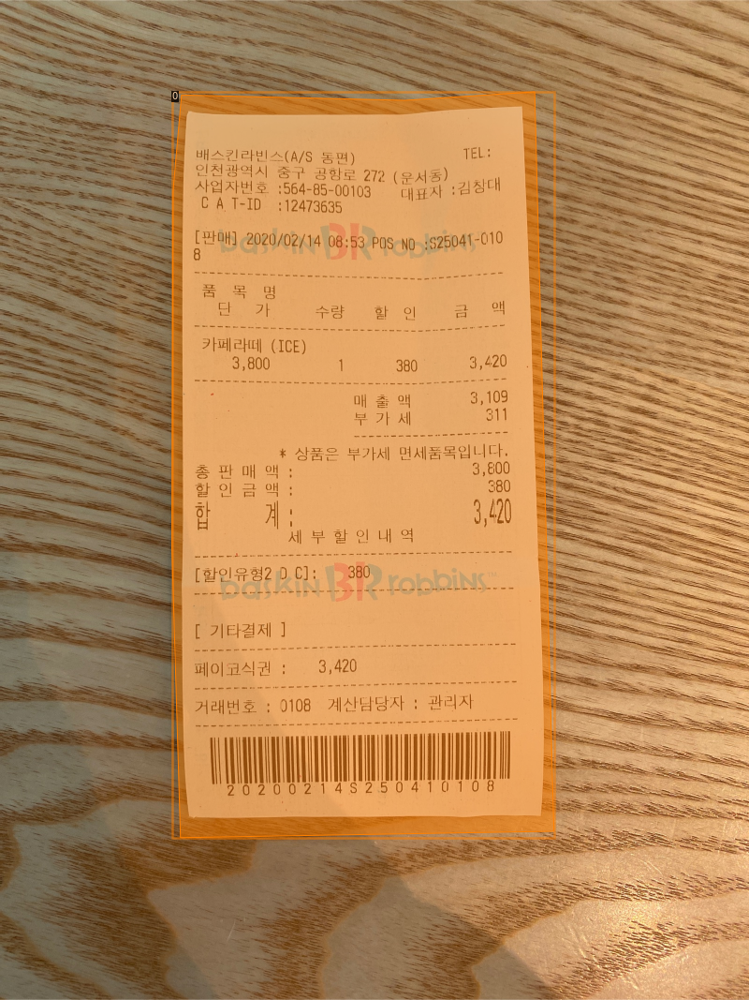

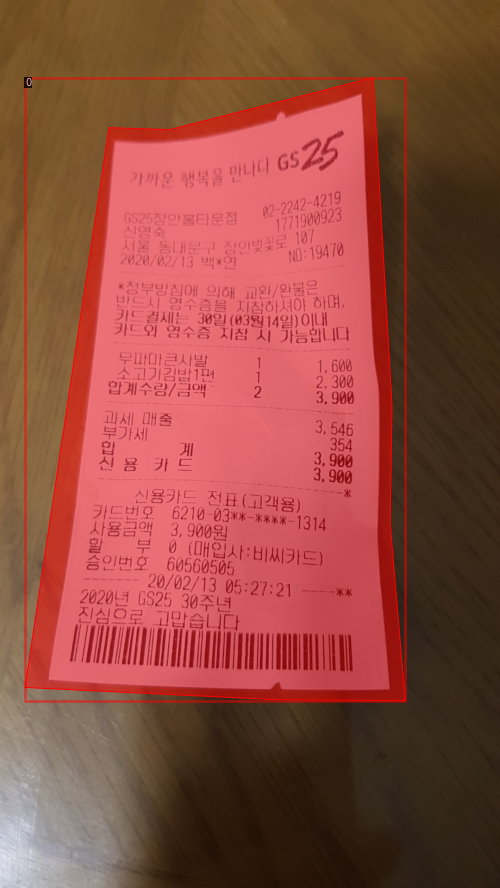

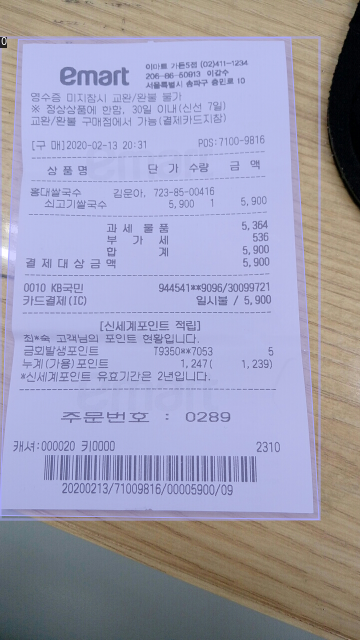

In [ ]:
#dataset_dicts = get_receipt_dicts("train","train/receipt_coco.json")
dataset_dicts = get_receipt_dicts("train","train/receipt_coco.json")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], receipt_metadata_train, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Object Detection

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file("./detectron2_repo/configs/COCO-Detection/retinanet_R_50_FPN_3x.yaml")
cfg.DATASETS.TRAIN = ("train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"   # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 900
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # 클래스는 "영수증" 클래스 하나 뿐입니다.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

Loading config ./detectron2_repo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


[06/24 09:23:23 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

model_final_f10217.pkl: 178MB [00:15, 11.3MB/s]                           


[06/24 09:23:46 d2.engine.train_loop]: Starting training from iteration 0
[06/24 09:23:53 d2.utils.events]:  eta: 0:04:44  iter: 19  total_loss: 1.602  loss_cls: 1.142  loss_box_reg: 0.487  time: 0.3243  data_time: 0.0223  lr: 0.000005  max_mem: 3781M
[06/24 09:24:00 d2.utils.events]:  eta: 0:04:45  iter: 39  total_loss: 2.003  loss_cls: 1.450  loss_box_reg: 0.547  time: 0.3324  data_time: 0.0204  lr: 0.000010  max_mem: 3916M
[06/24 09:24:07 d2.utils.events]:  eta: 0:04:45  iter: 59  total_loss: 2.131  loss_cls: 1.553  loss_box_reg: 0.611  time: 0.3369  data_time: 0.0066  lr: 0.000015  max_mem: 3918M
[06/24 09:24:14 d2.utils.events]:  eta: 0:04:39  iter: 79  total_loss: 2.071  loss_cls: 1.514  loss_box_reg: 0.560  time: 0.3374  data_time: 0.0090  lr: 0.000020  max_mem: 3918M
[06/24 09:24:21 d2.utils.events]:  eta: 0:04:33  iter: 99  total_loss: 2.164  loss_cls: 1.563  loss_box_reg: 0.628  time: 0.3385  data_time: 0.0097  lr: 0.000025  max_mem: 3918M
[06/24 09:24:27 d2.utils.events]:  e

In [ ]:
# tensorboard를 사용해서 학습 커브를 살펴봅니다.
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
cfg.DATASETS.TEST = ("val", )
predictor = DefaultPredictor(cfg)

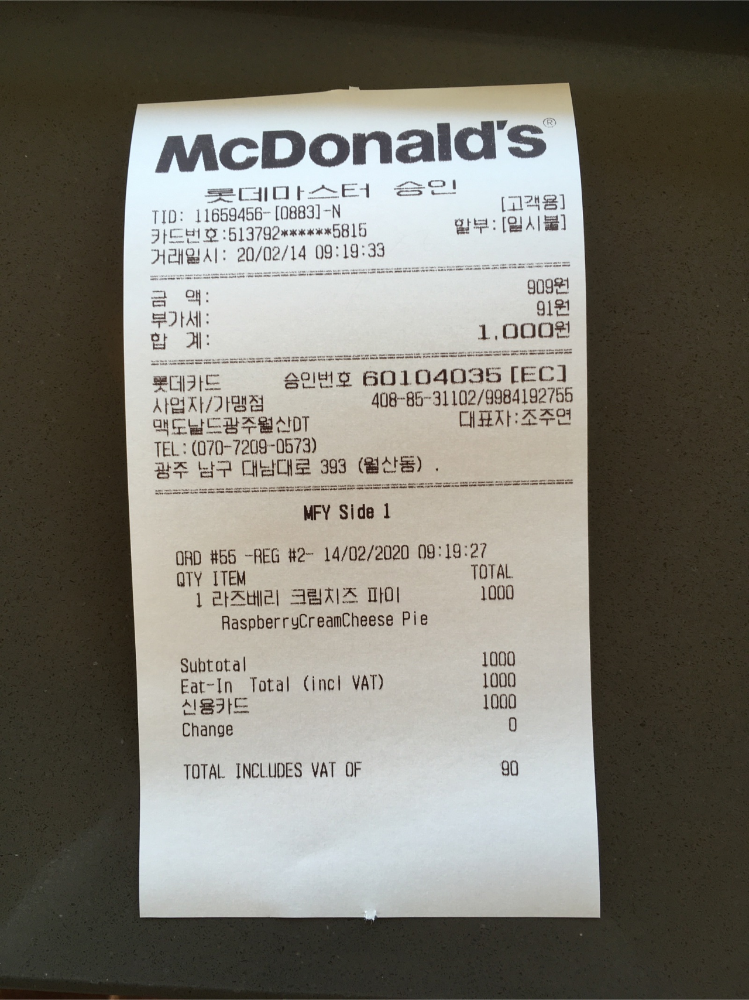

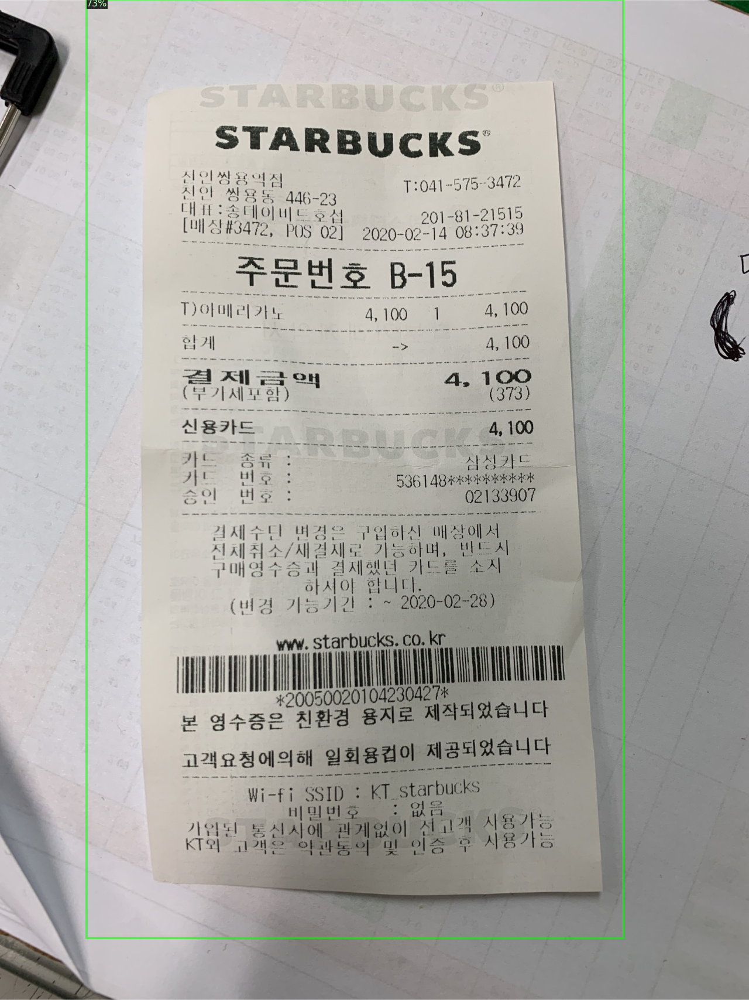

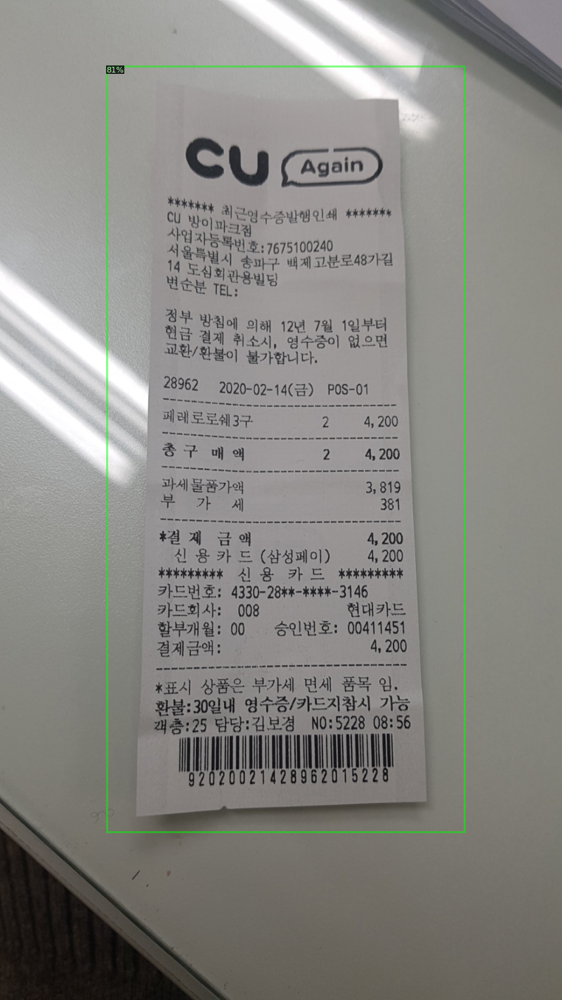

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_receipt_dicts("val","val/receipt_coco.json")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=receipt_metadata_train, 
                   scale=0.8
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "val")
inference_on_dataset(trainer.model, val_loader, evaluator)
# another equivalent way is to use trainer.test

[06/24 09:33:37 d2.data.datasets.coco]: Loaded 100 images in COCO format from val/receipt_coco.json
[06/24 09:33:37 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|  receipt   | 100          |
|            |              |
[06/24 09:33:37 d2.data.common]: Serializing 100 elements to byte tensors and concatenating them all ...
[06/24 09:33:37 d2.data.common]: Serialized dataset takes 0.04 MiB
[06/24 09:33:37 d2.evaluation.evaluator]: Start inference on 100 images
[06/24 09:33:39 d2.evaluation.evaluator]: Inference done 11/100. 0.1092 s / img. ETA=0:00:12
[06/24 09:33:44 d2.evaluation.evaluator]: Inference done 48/100. 0.1045 s / img. ETA=0:00:07
[06/24 09:33:49 d2.evaluation.evaluator]: Inference done 85/100. 0.1054 s / img. ETA=0:00:02
[06/24 09:33:51 d2.evaluation.evaluator]: Total inference time: 0:00:13.179777 (0.138734 s / img per device, on 1 devices)
[06/24 09:33:51 d2.evaluation.evaluator]: Total infe

OrderedDict([('bbox',
              {'AP': 66.5134921969019,
               'AP50': 100.0,
               'AP75': 87.2536165217674,
               'APl': 66.5134921969019,
               'APm': nan,
               'APs': nan})])

# Instance Segmentation

이제 학습을 진행할 단계입니다. COCO 데이터셋으로 학습된 R50-FPN Mask R-CNN 모델을 불러와서 영수증 데이터셋으로 fine-tune해 봅시다. Colab의 K80 GPU를 기준으로, 300 iterations 학습시키는데 대략 6분정도의 시간이 소요됩니다(P100 GPU의 경우 2분 가량 소요됩니다).

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file("./detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.DATASETS.TRAIN = ("train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"  # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 900    # 300 iterations 정도면 충분합니다. 더 오랜 시간도 시도해보세요.
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 1024   # 영수증 데이터셋과 같이 적당한 데이터셋에서는 이정도면 적당합니다, 작은 데이터셋은 124로 하면 됩니다.
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # 클래스는 "영수증" 클래스 하나 뿐입니다.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[06/24 09:33:59 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Unable to load 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model!
Unable to load 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model!
Unable to load 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model!
Unable to load 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model!
Unable to load 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (1, 256, 1, 1) in the model!
Unable to load 'roi_heads.mask_head.predictor.bias' to the model due to incompatible shapes: (80,) in the checkpoint but (1,) in the model!


[06/24 09:33:59 d2.engine.train_loop]: Starting training from iteration 0
[06/24 09:34:07 d2.utils.events]:  eta: 0:05:52  iter: 19  total_loss: 1.507  loss_cls: 0.747  loss_box_reg: 0.040  loss_mask: 0.695  loss_rpn_cls: 0.002  loss_rpn_loc: 0.008  time: 0.4020  data_time: 0.0234  lr: 0.000005  max_mem: 3918M
[06/24 09:34:15 d2.utils.events]:  eta: 0:05:40  iter: 39  total_loss: 1.318  loss_cls: 0.595  loss_box_reg: 0.038  loss_mask: 0.659  loss_rpn_cls: 0.001  loss_rpn_loc: 0.009  time: 0.3971  data_time: 0.0051  lr: 0.000010  max_mem: 3918M
[06/24 09:34:23 d2.utils.events]:  eta: 0:05:32  iter: 59  total_loss: 1.006  loss_cls: 0.366  loss_box_reg: 0.039  loss_mask: 0.593  loss_rpn_cls: 0.001  loss_rpn_loc: 0.010  time: 0.3955  data_time: 0.0058  lr: 0.000015  max_mem: 3918M
[06/24 09:34:31 d2.utils.events]:  eta: 0:05:26  iter: 79  total_loss: 0.797  loss_cls: 0.208  loss_box_reg: 0.036  loss_mask: 0.529  loss_rpn_cls: 0.001  loss_rpn_loc: 0.007  time: 0.3988  data_time: 0.0051  lr:

In [ ]:
# tensorboard를 사용해서 학습 커브를 살펴봅니다.
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 794), started 0:09:16 ago. (Use '!kill 794' to kill it.)

<IPython.core.display.Javascript object>

# 학습한 모델 실행 및 평가하기

영수증 데이터셋의 검증(validation) 데이터셋으로 테스트를 해볼 차례입니다.

우선, 방금 전 학습한 모델을 불러와서 predictor를 생성합니다.

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
cfg.DATASETS.TEST = ("val", )
predictor = DefaultPredictor(cfg)

샘플을 몇 개 뽑아 살펴봅니다.

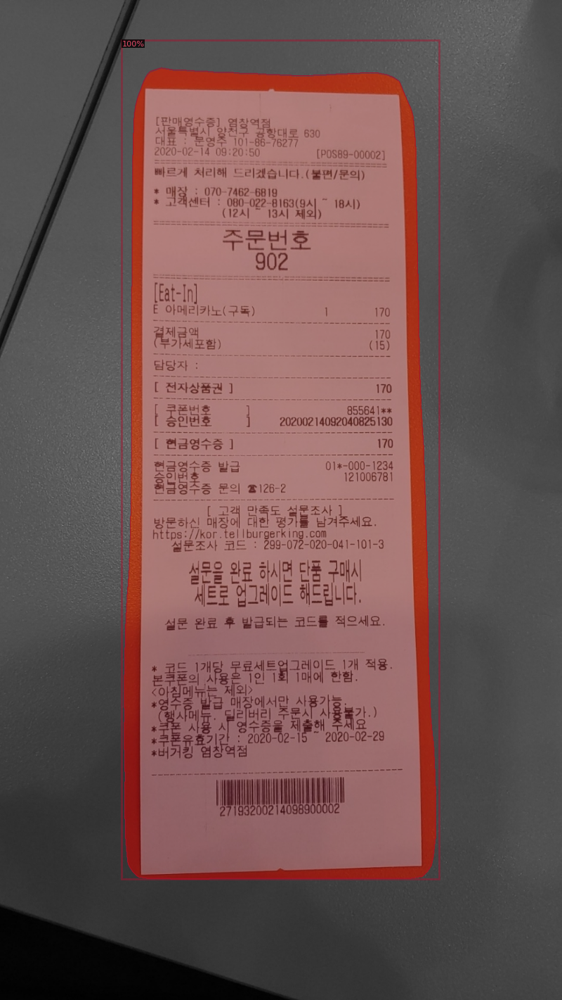

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


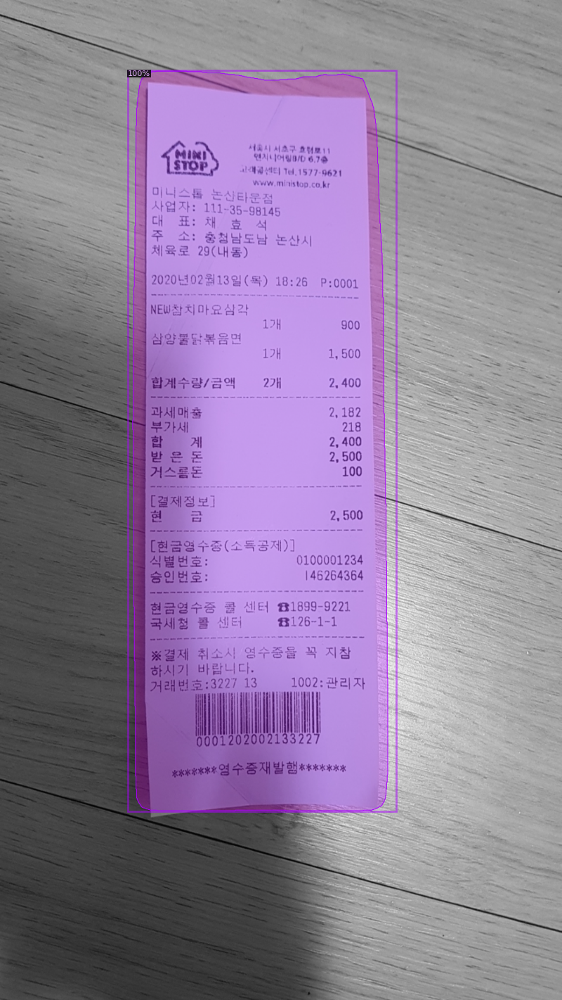

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


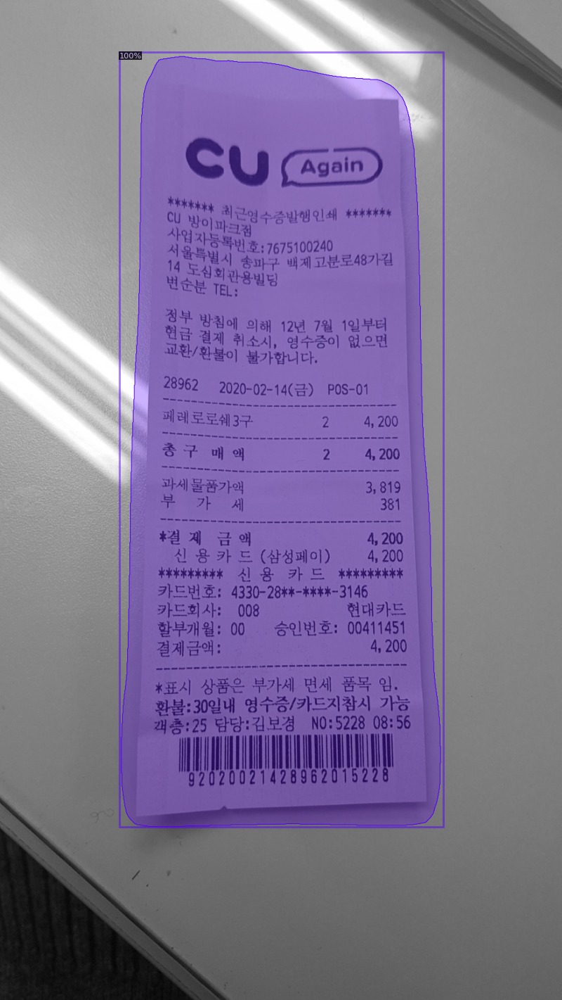

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


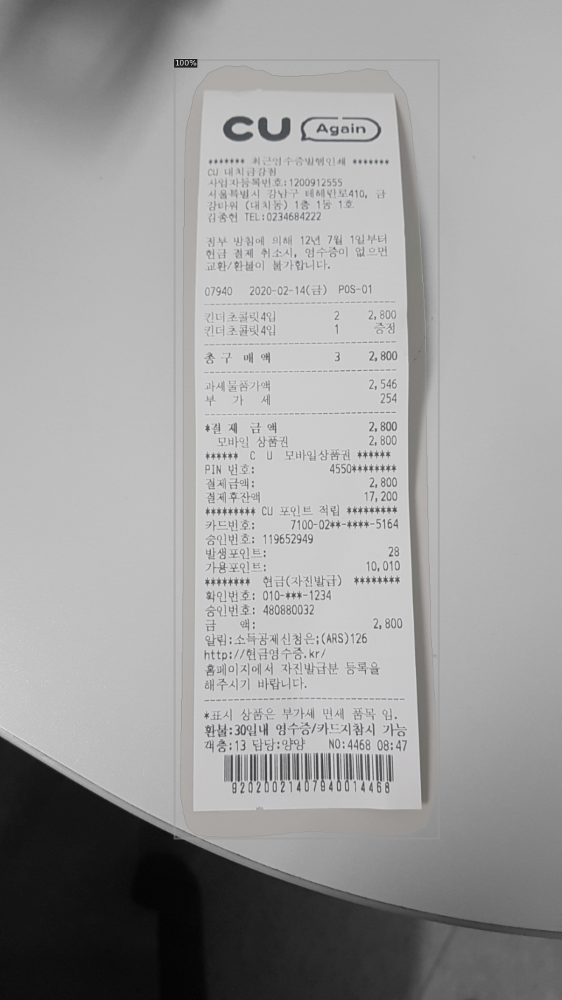

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


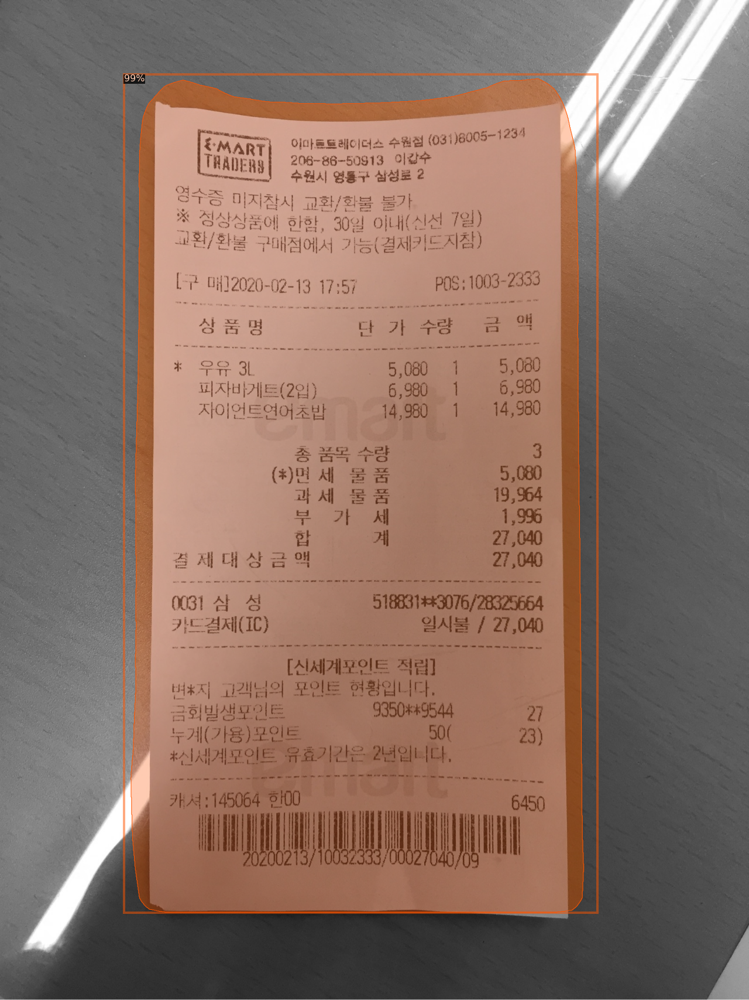

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [ ]:
from detectron2.utils.visualizer import ColorMode
from detectron2.utils.visualizer import GenericMask
from detectron2.utils.visualizer import VisImage
from detectron2.structures import BitMasks, Boxes, BoxMode, Keypoints, PolygonMasks, RotatedBoxes
dataset_dicts = get_receipt_dicts("val","val/receipt_coco.json")
for d in random.sample(dataset_dicts, 5):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=receipt_metadata_train, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
                   #instance_mode=ColorMode.SEGMENTATION
                   #instance_mode = GenericMask.mask_to_polygons

    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])
    VisImage.save(v, "./output/")

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "val")
inference_on_dataset(trainer.model, val_loader, evaluator)
# another equivalent way is to use trainer.test

[06/24 09:43:15 d2.data.datasets.coco]: Loaded 100 images in COCO format from val/receipt_coco.json
[06/24 09:43:15 d2.data.common]: Serializing 100 elements to byte tensors and concatenating them all ...
[06/24 09:43:15 d2.data.common]: Serialized dataset takes 0.04 MiB
[06/24 09:43:15 d2.evaluation.evaluator]: Start inference on 100 images
[06/24 09:43:17 d2.evaluation.evaluator]: Inference done 11/100. 0.0848 s / img. ETA=0:00:11
[06/24 09:43:22 d2.evaluation.evaluator]: Inference done 49/100. 0.0847 s / img. ETA=0:00:06
[06/24 09:43:28 d2.evaluation.evaluator]: Inference done 87/100. 0.0846 s / img. ETA=0:00:01
[06/24 09:43:29 d2.evaluation.evaluator]: Total inference time: 0:00:12.661933 (0.133284 s / img per device, on 1 devices)
[06/24 09:43:29 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:07 (0.083843 s / img per device, on 1 devices)
[06/24 09:43:29 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[06/24 09:43:29 d2.evaluation.coco_eval

OrderedDict([('bbox',
              {'AP': 87.51320415682079,
               'AP50': 100.0,
               'AP75': 100.0,
               'APl': 87.51320415682079,
               'APm': nan,
               'APs': nan}),
             ('segm',
              {'AP': 91.36725684876929,
               'AP50': 100.0,
               'AP75': 100.0,
               'APl': 91.36725684876929,
               'APm': nan,
               'APs': nan})])

In [ ]:
!ls output

coco_instances_results.json			   last_checkpoint
events.out.tfevents.1592990604.cf7be8113775.528.0  metrics.json
events.out.tfevents.1592991239.cf7be8113775.528.1  model_final.pth
instances_predictions.pth


# 구글 드라이브에 모델 저장하기

In [ ]:
# 1. Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

# 2. Create & upload a file text file.
# 특정 폴더 안으로 파일 삽입
uploaded = drive.CreateFile({'title': 'coco_instances_results.json', "parents": [{"kind": "drive#fileLink","id": '1q8wh-olZjAXxPlTsNl2-RGr9rn7w1hn5'}]})
uploaded.SetContentString('Sample upload file content')
uploaded.SetContentFile('output/coco_instances_results.json')
uploaded.Upload()
print('Uploaded file with ID {}'.format(uploaded.get('id')))
# 3. Load a file by ID and print its contents.
downloaded = drive.CreateFile({'id': uploaded.get('id')})

In [ ]:
for key in outputs.keys():
    print(key, ":", outputs[key])
    print(outputs['instances'].pred_masks)

In [ ]:
with open('output/coco_instances_results.json') as f :
    json_data = json.load(f)
json_data

[{'bbox': [200.35833740234375,
   53.55010986328125,
   1130.3310546875,
   1987.4599609375],
  'category_id': 1,
  'image_id': 1,
  'score': 0.9946946501731873,
  'segmentation': {'counts': 'SnR?4eP2_2^Ld3_Nb1VNX2RM\\3kmNeDc8h=VD`FS8V<oEUJc2T9jK]1hEg3R9]k0^Ob0^O`0A?A>B>C<C<E;F:H7I7J6I6K5J6K5K4L5J5M3L5K5L4K3N2M2N3N1N3N1N2O1N2O2M2O1N2O1O1N101N2O1O1N101N2O1O0O2O001N2O001N101O0O2O0000000000001O00000000000O100000000000000000000000000000000000000000001O0O100000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000

# BBOX CROP

In [ ]:
output_bboxes = []
for d in dataset_dicts:    
    im = cv2.imread(d["file_name"])
    output = predictor(im)
    #print(output["instances"].scores)
    pts = output["instances"].pred_boxes.tensor[0].tolist()
    output_bboxes.append(pts)
print(output_bboxes)

In [ ]:
output_bboxes[1]

In [ ]:
for number in range(len(output_bboxes)):
    pts = output_bboxes[number]
    a = pts[0], pts[1], pts[2], pts[3]

In [ ]:
import os
import random
output_bboxes = []
for d in dataset_dicts:    
    im = cv2.imread(d["file_name"])
    output = predictor(im)
    pts = output["instances"].pred_boxes.tensor[0].tolist()
    crop_img = im[int(pts[1])-1:int(pts[3])+1, int(pts[0])-1:int(pts[2])+1] 
    #cv2.imwrite('/content/drive/My Drive/img/crop'+ str(random.randrange(1,101)) + '.jpg',crop_img)
    cv2.imwrite('/content/drive/My Drive/img/crop_'+ str(d["file_name"]) + '.jpg',crop_img)

In [ ]:
from detectron2.data.detection_utils import *

print(outputs["instances"])

print(outputs["instances"].pred_boxes.tensor[0])

pts = outputs["instances"].pred_boxes.tensor[0].tolist()
print(type(pts))
print(pts)

print(pts[0], pts[1], pts[2], pts[3])

crop_img = im[int(pts[1])-1:int(pts[3])+1, int(pts[0])-1:int(pts[2])+1]

cv2_imshow(crop_img)

In [ ]:
data_file = open('/content/drive/My Drive/datt/coco_instances_results.json', "r") 
#json_file = open('output/coco_instances_results.json', "r")

In [ ]:
import json
from collections import OrderedDict
 
with open('output/coco_instances_results.json', encoding="utf-8") as data_file:    
    data = json.load(data_file)#, object_pairs_hook=OrderedDict)


for item in data :
  print('id', item['image_id'], 'bbox', item['bbox'])

In [ ]:
tmp = []
for item in data :

    #print(item['bbox'])
    #print(type(item['bbox']))
    bbox = item['bbox']
    #print(bbox[0], bbox[1], bbox[2], bbox[3])
    #print('id', item['image_id'], 'score :', item['score'],'===', bbox)
    tmp.append([item['image_id'], item['score'], bbox[0], bbox[1], bbox[2], bbox[3]])
print(tmp[:])
print(tmp[3], tmp[4]) # 3번과 4번은 image_id가 같지만 다른 score를 가지고 있다. 스코어가 높은 것이 정확한 bbox를 가지고 있다.

if tmp[:][0] == tmp[1:][0] : # 만약 tmp에서 image_id가 같고
    if tmp[:][1] >= tmp[1:][1] : # 스코어가 더 크다면
        del tmp[:]
print(tmp)

In [ ]:
    crop_img = im[bbox[1]:bbox[3], bbox[0]:bbox[2]]
    cv2_imshow(crop_img)

In [ ]:
for d in dataset_dicts:    
    im = cv2.imread(d["file_name"])
    cv2_imshow(im)